In [2]:
#import era5plots

t2_vars = [
    "t2_max", "t2_min", "t2_mean",
]
surface_temp_vars = [
    "tsk_mean", "tsk_max", "tsk_min"
]
wind_vars = [
    "u10_max", "v10_max", "u10_mean", "v10_mean",
    "wdir10_mean", "wspd10_mean", "wspd10_max"
]
precipitation_vars = [
    "rainnc_sum", "rainc_sum", "snow_sum", "acsnow_sum"
]
cloud_vars = [
    "ctt_max", "ctt_min", "ctt_mean"
]
radiation_vars = [
    "swdnb_sum", "swdnbc_sum", "swupb_sum", "swupbc_sum",
    "lwdnb_sum", "lwdnbc_sum", "lwupb_sum", "lwupbc_sum"
]
energy_flux_vars = [
    "lh_sum", "hfx_sum"
]
moisture_vars = [
    "q2_mean", "rh2_mean", "rh2_max", "rh2_min"
]
surface_vars = [
    "sst_mean", "sst_max", "sst_min", "albedo_mean", "snowc_max", "snowh_mean", "seaice_max"
]
pressure_vars = [
    "psfc_mean", "slp_mean"
]
all_single_level_vars = (
    t2_vars +
    surface_temp_vars +
    wind_vars +
    precipitation_vars +
    cloud_vars +
    radiation_vars +
    energy_flux_vars +
    moisture_vars +
    surface_vars +
    pressure_vars
)

ak_locations = {
    "Anchorage": (61.2181, -149.9003),
    "Fairbanks": (64.8378, -147.7164),
    "Bethel": (60.7922, -161.7558),
    "Talkeetna": (62.3209, -150.1066),
    "Yakutat": (59.5469, -139.7270),
    "Valdez": (61.1308, -146.3483),
    "Point Hope": (68.3477, -166.8089),
    "Kotzebue": (66.8983, -162.5966),
    "Anaktuvuk Pass": (68.1336, -151.7352),
    "Nome": (64.5011, -165.4064),
    "Utqiaġvik": (71.2906, -156.7886),
    "Cordova": (60.5438, -145.7573),
}

In [7]:
from era5plots import *
import pandas as pd

def plot_daily_normals_two_periods(
    lat_lon_locations: dict,
    var_id: str,
    period_1: tuple[int, int] = (1960, 1989),
    period_2: tuple[int, int] = (1990, 2019),
    save: bool = False
):
    """Plot daily normals (mean by day-of-year) for two climatology periods at given locations."""

    locations = point_locations_to_test(lat_lon_locations)
    fps = list_files_for_variable(var_id)
    ds, ds_attrs = load_all_data_for_variable(fps)

    var = ds[var_id]

    def extract_daily_climatology(ds_subset: xr.DataArray, years: tuple[int, int]) -> xr.DataArray:
        """Compute daily climatology over a specified year range."""
        period = ds_subset.sel(time=slice(f"{years[0]}-01-01", f"{years[1]}-12-31"))
        return period.groupby("time.dayofyear").mean("time", keep_attrs=True)

    x_coords = np.array([x for x, y in locations.values()])
    y_coords = np.array([y for x, y in locations.values()])
    names = list(locations.keys())

    points_da = var.sel(
        x=xr.DataArray(x_coords, dims='point', coords={'point': names}),
        y=xr.DataArray(y_coords, dims='point', coords={'point': names}),
        method='nearest',
        tolerance=5000
    )

    clim1 = extract_daily_climatology(points_da, period_1)
    clim2 = extract_daily_climatology(points_da, period_2)

    fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(18, 20), sharex=True, sharey=True)
    axes = axes.flatten()

    unit = ds_attrs["units"]
    if unit == "degree_C":
        unit = "°C"

    var_name = ds_attrs.get("standard_name", var_id).replace("_", " ").title()
    desc = ds_attrs.get("long_name", var_id)


    fig.suptitle(f"Daily Normals: {desc} ({unit})\n{period_1[0]}–{period_1[1]} vs {period_2[0]}–{period_2[1]}", 
                 fontsize=17, y=1.02)

    for idx, (loc, ax) in enumerate(zip(locations, axes)):
        if idx >= len(locations):
            ax.set_visible(False)
            continue

        ax.plot(clim1["dayofyear"], clim1.sel(point=loc), label=f"{period_1[0]}–{period_1[1]}", color="#1f77b4")
        ax.plot(clim2["dayofyear"], clim2.sel(point=loc), label=f"{period_2[0]}–{period_2[1]}", color="#d62728")

        ax.set_title(loc, fontsize=12)
        ax.grid(True, alpha=0.3)

    # Labels
    for ax in axes[-3:]:
        ax.set_xlabel("Day of Year", fontsize=10)
    for ax in axes[::3]:
        ax.set_ylabel(f"{var_name} ({unit})", fontsize=10)

    # Legend
    handles, labels = axes[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper left', fontsize=13)

    plt.tight_layout()
    if save:
        fname = f"{var_id}_daily_normals_{period_1[0]}_{period_2[1]}.png"
        plt.savefig(f"figures/{fname}", dpi=200, bbox_inches='tight')
    plt.show()

    ds.close()


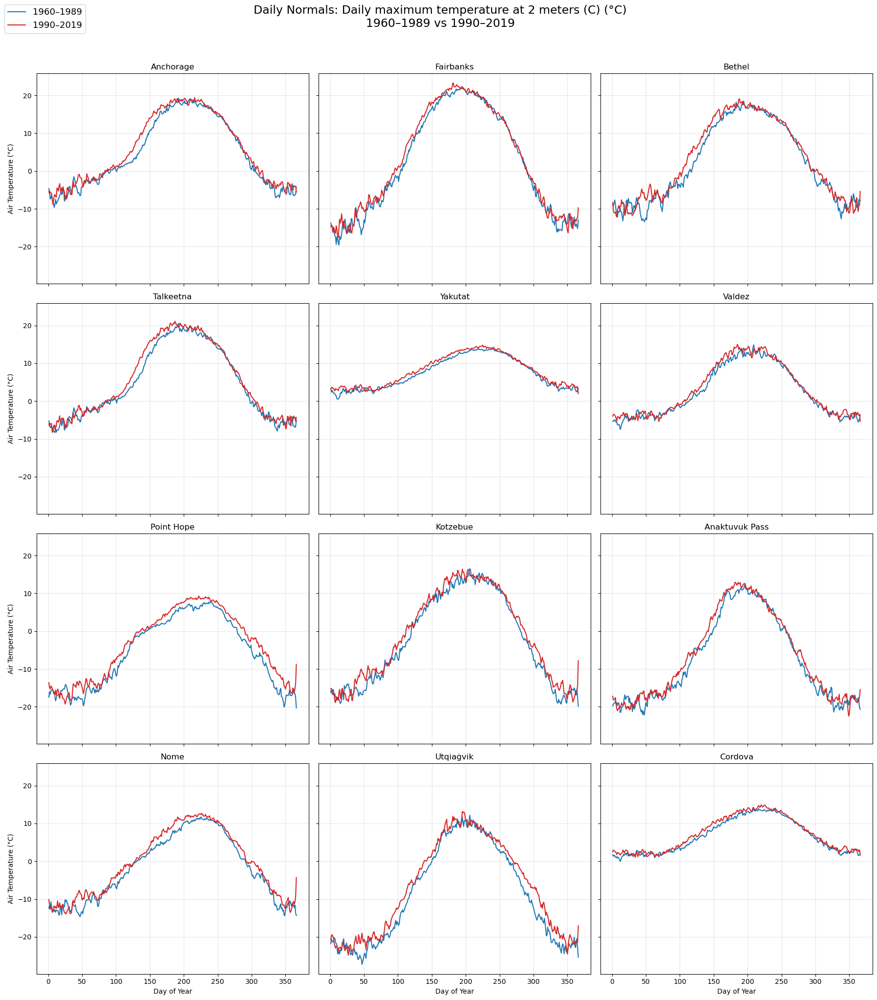

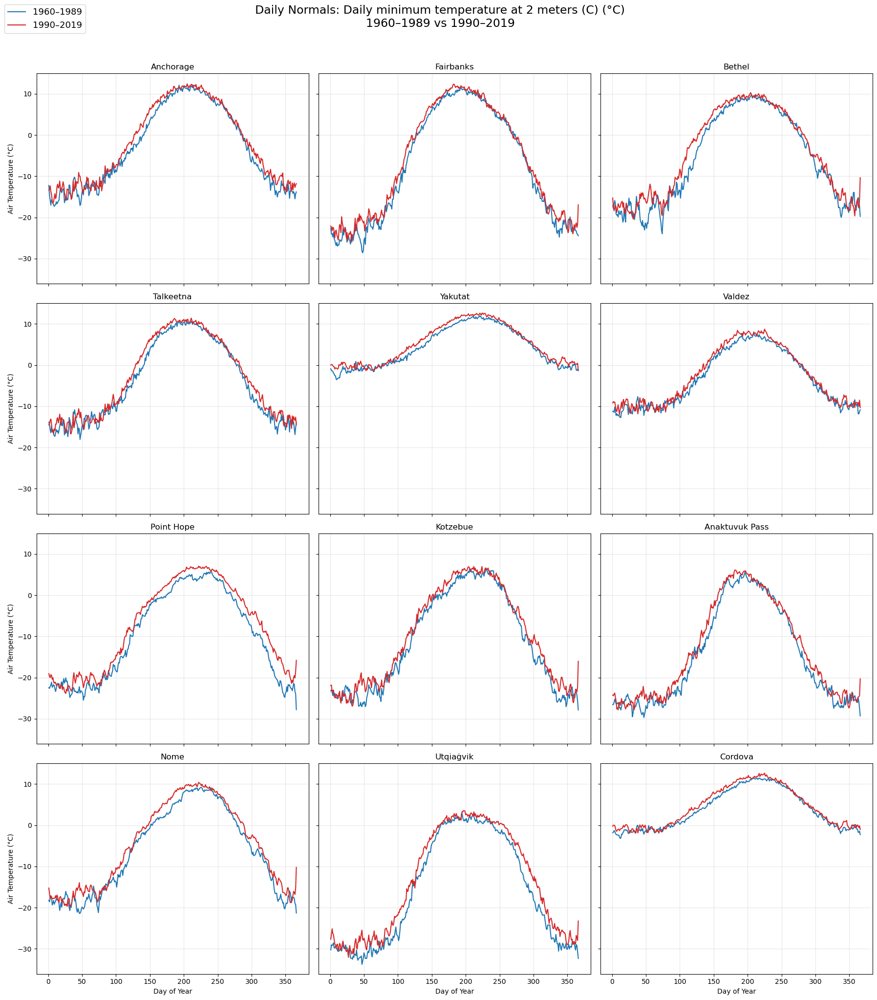

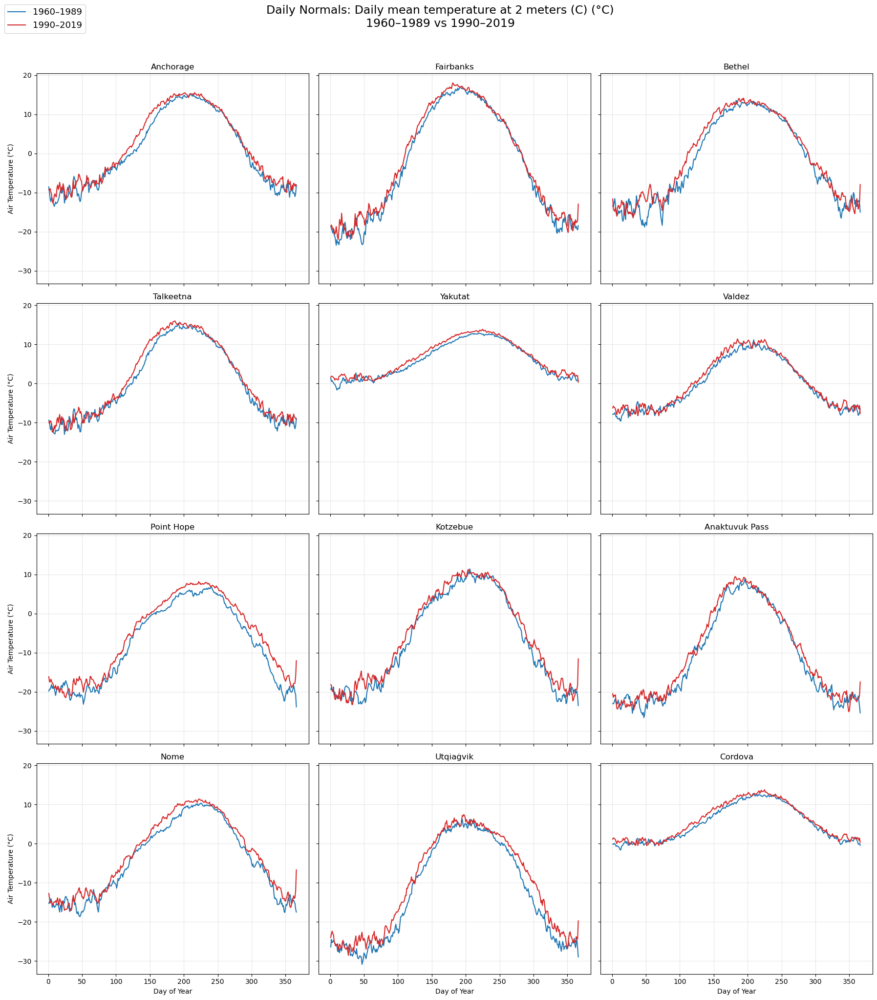

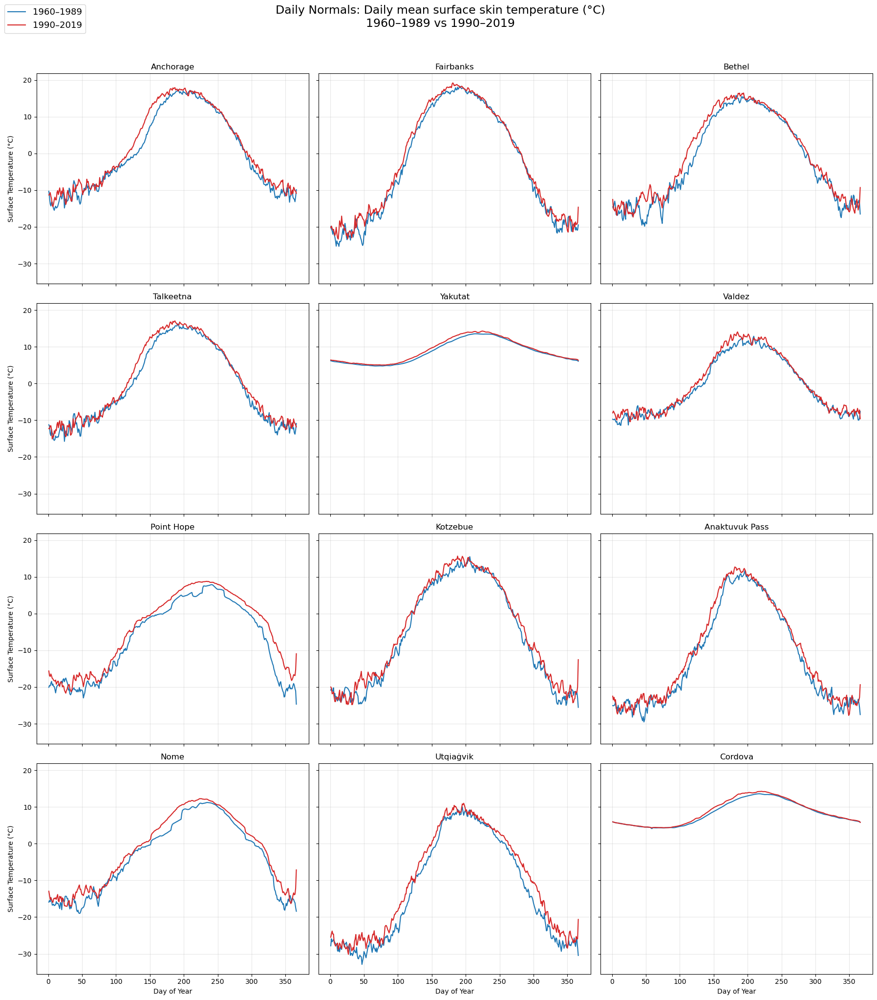

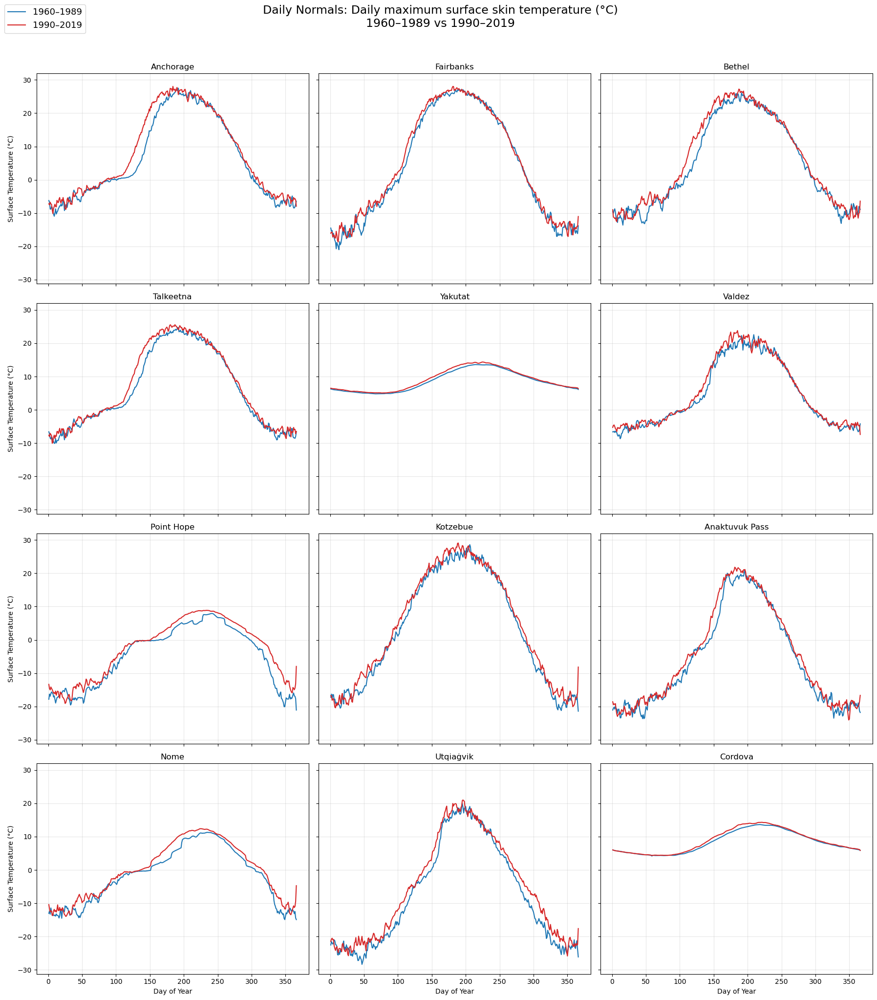

...

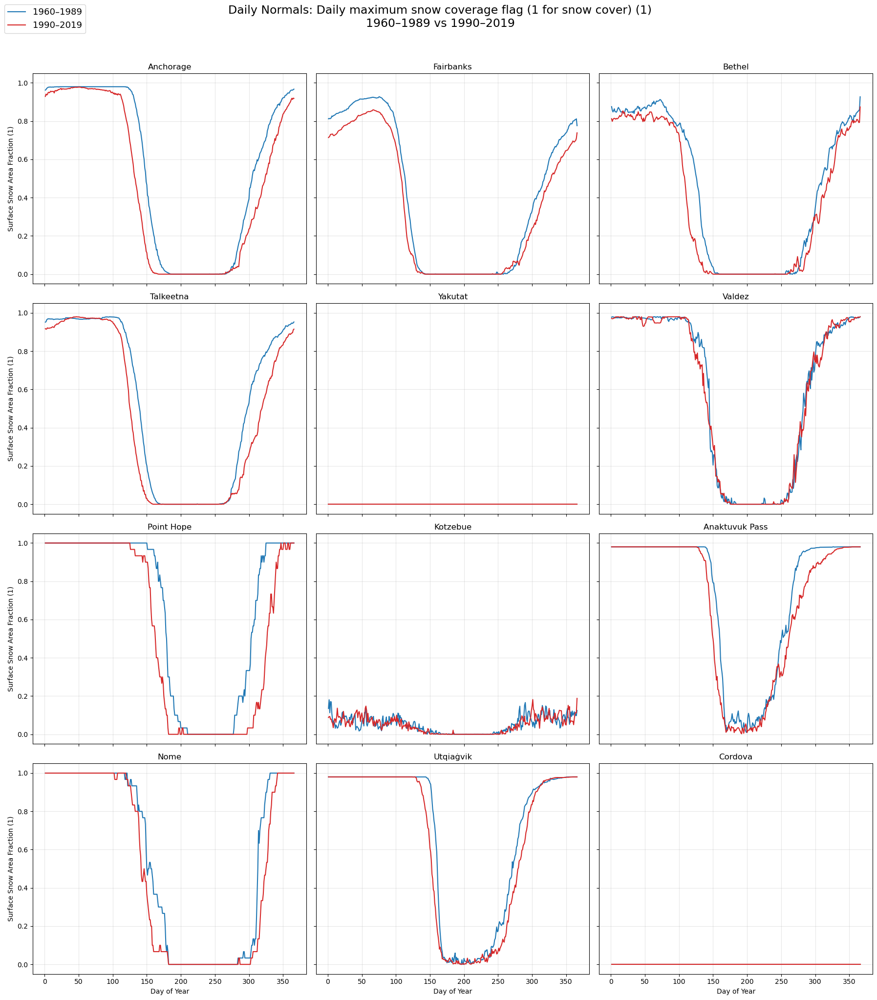

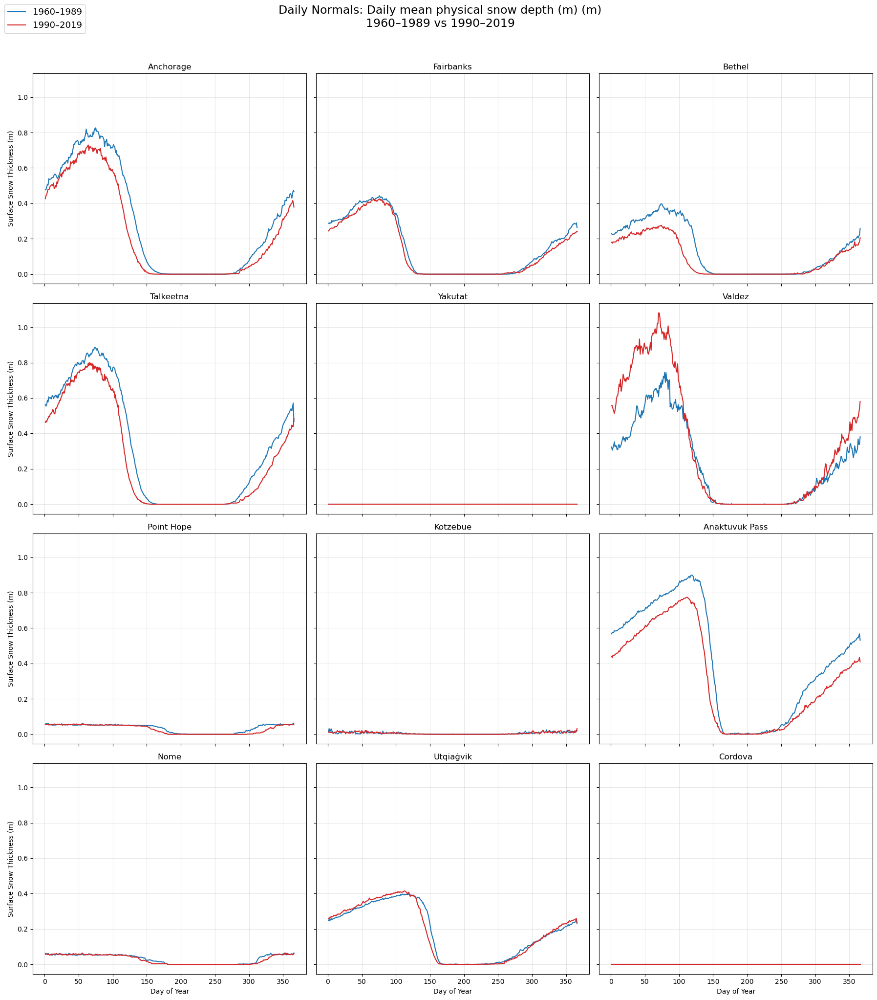

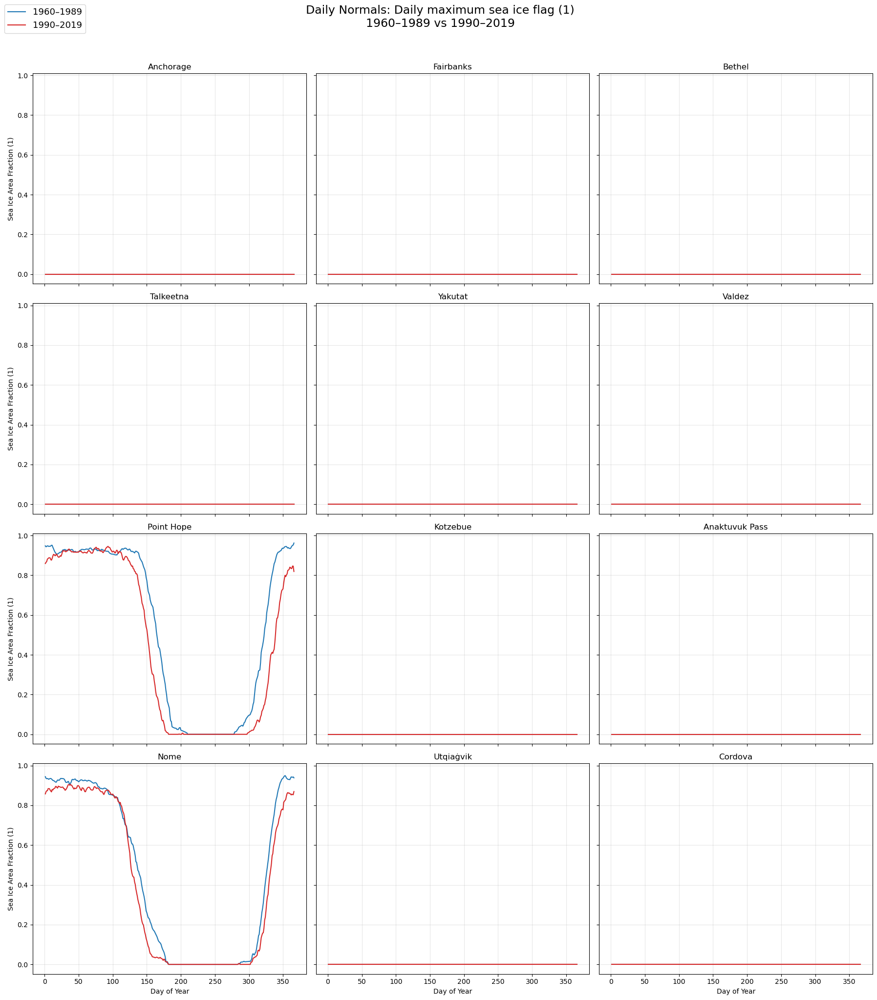

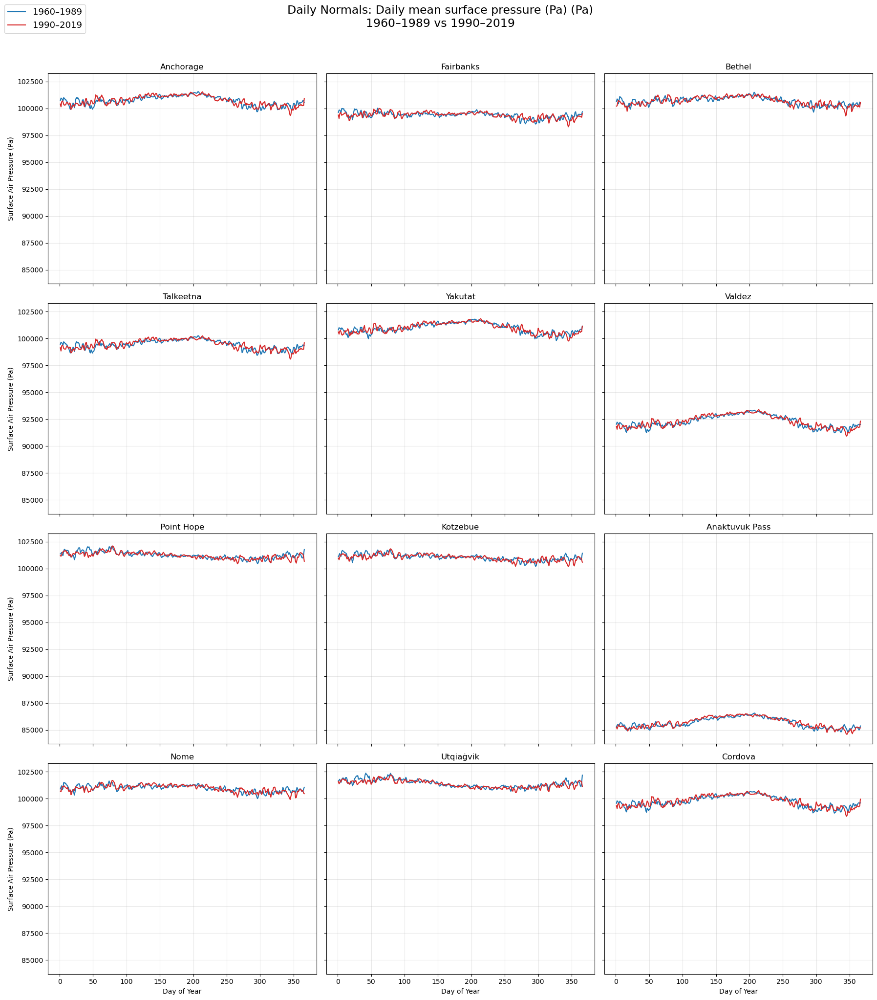

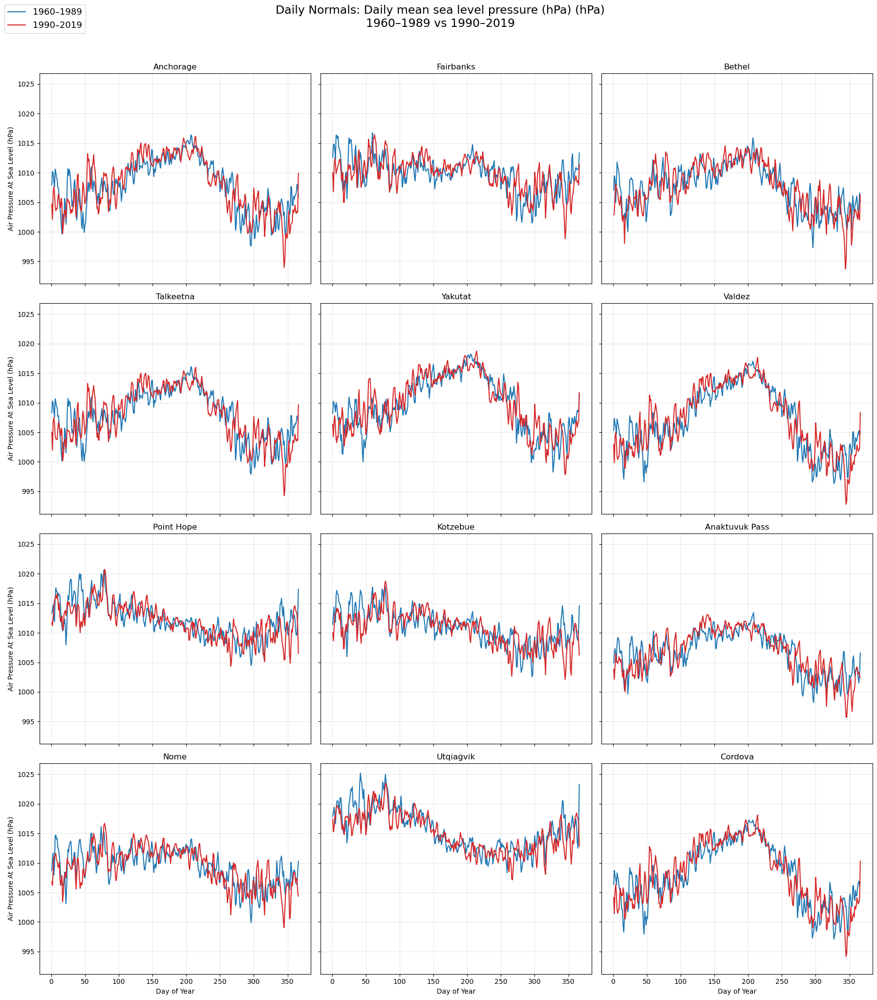

In [9]:
for v in all_single_level_vars:
    plot_daily_normals_two_periods(ak_locations, var_id=v)
